# Q7 Social Media Network Analysis

In [36]:
import random
import networkx as nx
from igraph import *
import matplotlib.pyplot as plt
from collections import deque

## 1. Load the Social Media Network as a Graph

In [37]:
# Read data and check node range
file_path = 'Data_Q7/socialmedia.graph.txt'

# Open file and skip comment lines
nodes = set()
with open(file_path, 'r') as file:
    for line in file:
        if not line.startswith('#'):
            edge = line.strip().split()
            nodes.add(int(edge[0]))
            nodes.add(int(edge[1]))

print("Minimum node ID:", min(nodes))
print("Maximum node ID:", max(nodes))

Minimum node ID: 1
Maximum node ID: 1157827


In [3]:
# Constructing a graph using edge tables
edges = []
with open(file_path, 'r') as file:
    for line in file:
        if not line.startswith('#'):
            edge = line.strip().split()
            edges.append((int(edge[0]), int(edge[1])))

# Create a graph and add edges, with nodes starting from 1
max_node = max(max(edge) for edge in edges)
g = Graph()
g.add_vertices(max_node)
g.add_edges([(source - 1, target - 1) for source, target in edges])

In [4]:
num_nodes = g.vcount()
print("Number of nodes in the graph:", num_nodes)

Number of nodes in the graph: 1157827


## 2. Customized Graph Visualization Method

In [5]:
def plot_subgraph(g, input_node_list=None):
    '''
    Build and Visulize a subgraph containing:
    1.the 10 most influential nodes, 
    2.their 20 most influential neighbors, 
    3.their 30 most influential neighbors' neighbors
    '''
    if input_node_list is not None:
        # Visualization for a node list
        most_influential_nodes_degrees = {n: g.degree(n) for n in input_node_list}
        most_influential_nodes = sorted(most_influential_nodes_degrees, key=most_influential_nodes_degrees.get, reverse=True)[:10]
    else:
        # Visualization for a graph
        degree_centrality = g.degree()
        most_influential_nodes = sorted(range(len(degree_centrality)), key=lambda x: degree_centrality[x], reverse=True)[:10]
    
    inner_nodes = most_influential_nodes.copy()
    midle_nodes = inner_nodes.copy()
    outer_nodes = midle_nodes.copy()
    
    for inner_node in inner_nodes:
        neighbors_of_inner = g.neighbors(inner_node)
        neighbor_of_inner_degrees = {n: g.degree(n) for n in neighbors_of_inner}

        top_neighbors_of_inner = sorted(neighbor_of_inner_degrees, key=neighbor_of_inner_degrees.get, reverse=True)[:20]

        midle_nodes.extend(top_neighbors_of_inner)  # midle_nodes COVER inner_nodes
        outer_nodes.extend(top_neighbors_of_inner)  # outer_nodes COVER inner_nodes

        for midle_node in midle_nodes:
            neighbors_of_midle = g.neighbors(midle_node)
            neighbor_of_midle_degrees = {n: g.degree(n) for n in neighbors_of_midle}

            top_neighbors_of_middle = sorted(neighbor_of_midle_degrees, key=neighbor_of_midle_degrees.get,
                                             reverse=True)[:30]

            outer_nodes.extend(top_neighbors_of_middle)  # outer_nodes COVER midle_nodes

    # Deduplicated
    midle_nodes = list(set(midle_nodes))
    outer_nodes = list(set(outer_nodes))

    # Subgraph with the nodes of interest
    subgraph = g.subgraph(outer_nodes)

    # Mapping dictionary from original graph indices to subgraph indices
    mapping = {subgraph.vs[node_idx].index: node for node_idx, node in enumerate(outer_nodes)}

    # Get vertices colors and sizes for the subgraph using the mapping dictionary
    vertex_colors = ['#3182bd' if mapping[subgraph.vs[i].index] in inner_nodes else (
        '#31a354' if mapping[subgraph.vs[i].index] in midle_nodes else '#e6550d') for i in range(len(subgraph.vs))]
    vertex_sizes = [10 if mapping[subgraph.vs[i].index] in inner_nodes else (
        4 if mapping[subgraph.vs[i].index] in midle_nodes else 1) for i in range(len(subgraph.vs))]

    # Plotting
    visual_style = {}
    visual_style["layout"] = subgraph.layout_fruchterman_reingold(seed=random.seed(42)) # Random Seeds
    visual_style["vertex_color"] = vertex_colors
    visual_style["vertex_size"] = vertex_sizes
    visual_style["edge_color"] = '#AAAAAA'
    visual_style["edge_width"] = 0.1
    
    return plot(subgraph,  **visual_style)

In [6]:
def Important_Note(text):
    print('\033[1m' + '\033[91m' + text + '\033[0m')

Important_Note("Important reminder: 【the ID of the graph generated by the IGRAPH】 ≠ 【the ID in the original edge table】\n")
Important_Note("【the ID in the original edge table】= 1 +【the ID of the graph generated by the IGRAPH】\n")

def original_ID(list_with_in_graph_ID):
    return [ID+1 for ID in list_with_in_graph_ID]

Important reminder: 【the ID of the graph generated by the IGRAPH】 ≠ 【the ID in the original edge table】

【the ID in the original edge table】= 1 +【the ID of the graph generated by the IGRAPH】



## 3. Graph Analysis on Social Media Network

### (1) Clustering Coefficient AND Degree Distribution

In [7]:
# Calculate the Global clustering coefficient
glb_clustering_coefficient = g.transitivity_undirected()
print("Global Clustering Coefficient:", glb_clustering_coefficient)

# Calculate the Average clustering coefficient
avg_clustering_coefficient = g.transitivity_avglocal_undirected()
print("Average Clustering Coefficient:", avg_clustering_coefficient)

Global Clustering Coefficient: 0.006218559818028638
Average Clustering Coefficient: 0.1722579595214077


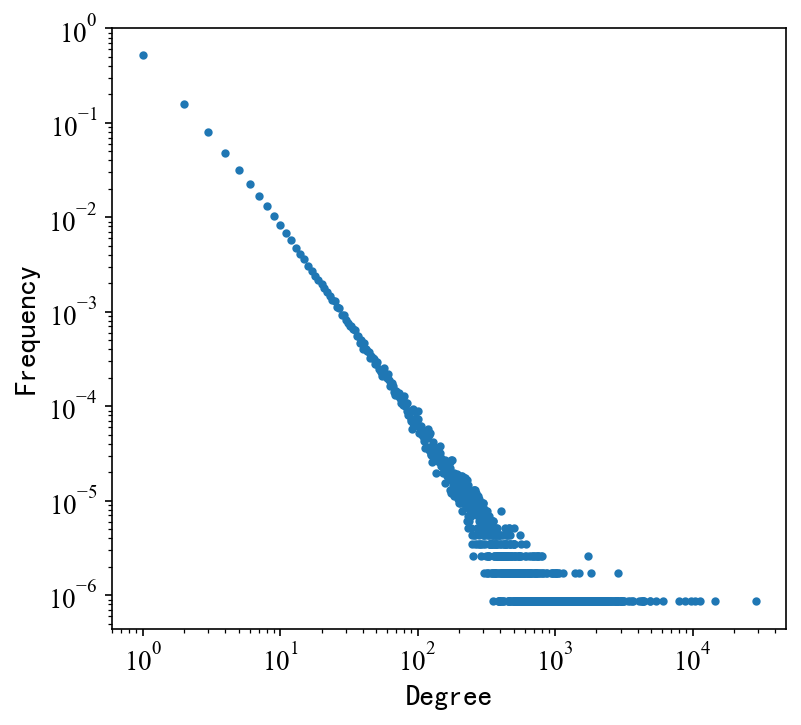

In [8]:
# Obatain degree distribution
degree_distribution = g.degree_distribution()

# Obatain degree and frequency
degrees = [degree[0] for degree in degree_distribution.bins() if degree[0] != 0]
frequency = [degree[2] / g.vcount() for degree in degree_distribution.bins() if degree[0] != 0]

# Degree's Log Distribution 
plt.figure(figsize=(5.8, 5.2), dpi=150)
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.xlabel("Degree", size=14)
plt.ylabel("Frequency", size=14)
plt.xticks(fontproperties='Times New Roman', size=13)
plt.yticks(fontproperties='Times New Roman', size=13)
plt.loglog(degrees, frequency, '.')
plt.show()

### (2)  The Most Influential Nodes

In [9]:
# use degree centrality AS centrality metrics
degree_centrality = g.degree()

# The Most Influential Nodes
most_influential_nodes = sorted(range(len(degree_centrality)), key=lambda x: degree_centrality[x], reverse=True)[:10]
print("Most Influential Nodes ID:", original_ID(most_influential_nodes))

Most Influential Nodes ID: [1072, 363, 35661, 106, 482709, 663931, 929, 808, 27837, 108624]


In [10]:
#Visualization
print("Most 10 influential nodes in Graph (Showed with BLUE BIG POINT)")
plot_subgraph(g, most_influential_nodes)

Most 10 influential nodes in Graph (Showed with BLUE BIG POINT)


### (3) Isolated Nodes

In [15]:
#Identify Isolated Nodes in the net work
isolated_nodes = g.vs.select(_degree=0)
isolated_nodes_ids = isolated_nodes.indices
print("Number of Isolated Nodes: ",len(isolated_nodes_ids))
print("Isolated Nodes:", original_ID(isolated_nodes_ids))

Number of Isolated Nodes:  22937
Isolated Nodes: [635474, 635475, 635476, 635477, 635478, 635479, 635480, 635481, 635482, 635483, 635484, 635485, 635486, 635489, 635490, 635491, 635492, 635494, 635495, 635496, 635497, 635499, 635500, 635502, 635503, 635504, 635506, 635507, 635513, 635514, 635515, 635516, 635518, 635519, 635520, 635521, 635522, 635523, 635524, 635525, 635526, 635528, 635529, 635530, 635532, 635533, 635534, 635535, 635536, 635537, 635538, 635539, 635540, 635543, 635544, 635546, 635547, 635548, 635550, 635551, 635552, 635553, 635554, 635556, 635557, 635558, 635559, 635560, 635561, 635562, 635563, 635564, 635565, 635566, 635568, 635569, 635570, 635571, 635572, 635573, 635574, 635575, 635576, 635578, 635579, 635580, 635581, 635582, 635583, 635584, 635585, 635586, 635587, 635588, 635589, 635590, 635591, 635592, 635593, 635594, 635595, 635596, 635597, 635598, 635599, 635600, 635601, 635602, 635603, 635604, 635606, 635607, 635608, 635609, 635610, 635611, 635612, 635613, 635614

10 isolated nodes example in Graph (Showed with BLUE BIG POINT)


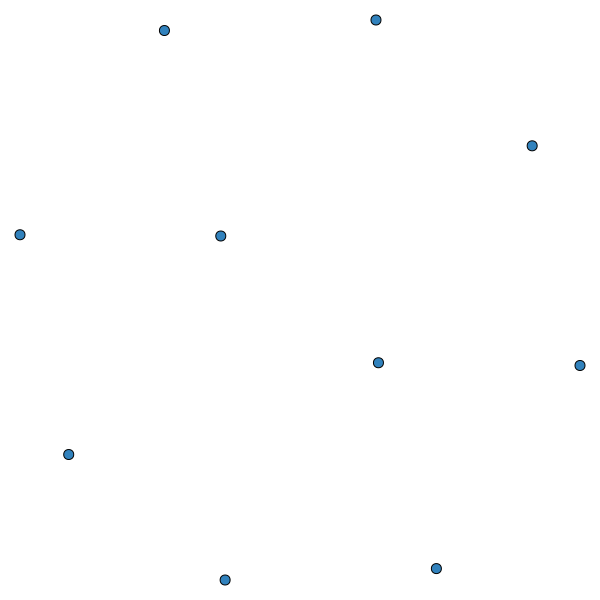

In [14]:
# visualization()
print("10 isolated nodes example in Graph (Showed with BLUE BIG POINT)")
plot_subgraph(g, isolated_nodes_ids[:10])

### (4) Connected Components

In [16]:
# Recognize Connected Components
connected_components = g.connected_components()

Important_Note("Important reminder: The ID displayed here is 【the ID of the graph generated by the IGRAPH】, not 【the ID in the original edge table】\n")
Important_Note("(【the ID in the original edge table】= 1 +【the ID of the graph generated by the IGRAPH】)\n")
print("Connected Components:", connected_components)

Important reminder: The ID displayed here is 【the ID of the graph generated by the IGRAPH】, not 【the ID in the original edge table】

(【the ID in the original edge table】= 1 +【the ID of the graph generated by the IGRAPH】)

Connected Components: Clustering with 1157827 elements and 22938 clusters
[    0] 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
        20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36,
        37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
        54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70,
        71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87,
        88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
        118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131,
        132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145,
        146,

In [19]:
# Assuming 'g' is your graph object
connected_components = g.components()

# Get the sizes of connected components and non-isolated nodes within each component
component_sizes = connected_components.sizes()
non_isolated_nodes = [size for size in component_sizes if size > 1]

# Calculate the number of non-isolated nodes in each connected component
num_non_isolated_nodes = sum(non_isolated_nodes)

# Get the largest connected component
largest_connected_component = connected_components.giant()

print("Connected Components: Clustering with 1157827 elements and 22938 clusters")
print("Number of non-isolated nodes in each non-isolated-connected-component:", non_isolated_nodes)
print("Total number of non-isolated nodes in all connected components:", num_non_isolated_nodes)

Connected Components: Clustering with 1157827 elements and 22938 clusters
Number of non-isolated nodes in each non-isolated-connected-component: [1134890]
Total number of non-isolated nodes in all connected components: 1134890


In [20]:
print("All non-isolated nodes are in a simple connected components")

All non-isolated nodes are in a simple connected components


In [21]:
# # Visualization （Same as "Most 10 influential nodes in Graph (Showed with BLUE BIG POINT)" above）
# print("10 most influential nodes of Connected components which is not a simple node")
# plot_subgraph(g, connected_components[0])

### (5) Average Shortest Path Length

**I find that it is unable to withstand precise calculations, so we need try the approximate calculation**

In [23]:
# # Unable to withstand precise calculations
# avg_shortest_path_length = g.average_path_length()
# print("Average Shortest Path Length:", avg_shortest_path_length)

In [46]:
def approximate_avg_shortest_path_length(graph, sample_size):
    # Get the largest connected component
    largest_cc = graph.components().giant()

    # Randomly select a specified number of nodes within the largest connected component
    random_nodes = random.sample(largest_cc.vs.indices, min(sample_size, len(largest_cc.vs)))

    # Construct a subgraph
    subgraph = largest_cc.induced_subgraph(random_nodes)

    # Calculate the average shortest path length of the subgraph
    avg_shortest_path = subgraph.average_path_length()

    return avg_shortest_path

In [47]:
approx_length_20000 = approximate_avg_shortest_path_length(g, 20000)
approx_length_50000 = approximate_avg_shortest_path_length(g, 50000)
approx_length_100000 = approximate_avg_shortest_path_length(g, 100000)

print(f"approximate_avg_shortest_path_length on 20000 nodes: {approx_length_50000}")
print(f"approximate_avg_shortest_path_length on 50000 nodes: {approx_length_20000}")
print(f"approximate_avg_shortest_path_length on 100000 nodes: {approx_length_100000}")

approximate_avg_shortest_path_length on 20000 nodes: 7.148390350787779
approximate_avg_shortest_path_length on 50000 nodes: 3.198293474342026
approximate_avg_shortest_path_length on 100000 nodes: 6.104620772135786


After computing the avg_shortest_path_length for various magnitudes of randomly selected nodes, I observed that its range should fall between 5 and 7. With a total of 1,157,827 nodes, where only one non-isolated connected component exists - the largest connected component comprising 1,134,890 nodes - I iterated 11 times, computing avg_shortest_path_length by randomly sampling 100,000 nodes each time. Finally, I used the average of these computations as an estimation for avg_shortest_path_length.

In [26]:
sample_size = 100000
num_iterations = 11

avg_shortest_paths = []

for _ in range(num_iterations):
    avg_shortest_path = approximate_avg_shortest_path_length(g, sample_size)
    avg_shortest_paths.append(avg_shortest_path)

# iterated 11 times, computing avg_shortest_path_length by randomly sampling 100,000 nodes each time.
approximate_avg_shortest_path_length = sum(avg_shortest_paths) / len(avg_shortest_paths)
print("Approximate Average Shortest Path Length:", approximate_avg_shortest_path_length)

Approximate Average Shortest Path Length: 6.00502367886632


In [48]:
sample_size = 20000
num_iterations = 40

avg_shortest_paths = []

for _ in range(num_iterations):
    avg_shortest_path = approximate_avg_shortest_path_length(g, sample_size)
    avg_shortest_paths.append(avg_shortest_path)

# iterated 11 times, computing avg_shortest_path_length by randomly sampling 100,000 nodes each time.
approximate_avg_shortest_path_length = sum(avg_shortest_paths) / len(avg_shortest_paths)
print("Approximate Average Shortest Path Length:", approximate_avg_shortest_path_length)

Approximate Average Shortest Path Length: 6.221385325836316


### (6) Diameter of the Network

#### It is unable to withstand precise calculations when I use diameter() directly

**Time complexity: $O(n^3)$**

In [27]:
# # Unable to withstand precise calculations
# diameter = g.diameter()
# print("Network Diameter:", diameter)

#### Only Networkx has an Approximate Method to calculate the diameter

In [28]:
import networkx as nx
file_path = 'Data_Q7/socialmedia.graph.txt'
G = nx.read_edgelist(file_path, nodetype=int)
diameter_estimate = nx.algorithms.approximation.diameter(G)
print("Approximate Diameter:", diameter_estimate)

Approximate Diameter: 24


#### My customized method （also unbearable）

**Time complexity: $O(V(V+E))$**

In [29]:
# # Define a function to compute the maximum distance (eccentricity) from a node to other nodes
# def compute_eccentricity(graph, node, sample_size=100000):
#     distances = [float('inf')] * graph.vcount()
#     distances[node] = 0
    
#     # Randomly select a specified number of nodes within the largest connected component
#     random_nodes = random.sample(graph.vs.indices, min(sample_size, len(graph.vs)))

#     # Construct a subgraph
#     subgraph = graph.induced_subgraph(random_nodes)

#     queue = deque([node])
#     while queue:
#         current_node = queue.popleft()
#         for neighbor in subgraph.neighbors(current_node):
#             if distances[neighbor] == float('inf'):
#                 distances[neighbor] = distances[current_node] + 1
#                 queue.append(neighbor)

#     max_distance = max(distances)
#     return max_distance if max_distance != float('inf') else 0


# # Initialize upper and lower bounds of the diameter
# diameter_upper_bound = 0
# diameter_lower_bound = float('inf')

# # Compute eccentricity for each node in the largest connected component
# for node in largest_component.vs:
#     eccentricity = compute_eccentricity(largest_component, node.index)
#     print(eccentricity)
#     # Update upper and lower bounds of the diameter
#     if eccentricity > diameter_upper_bound:
#         diameter_upper_bound = eccentricity
    
#     if eccentricity < diameter_lower_bound:
#         diameter_lower_bound = eccentricity

# # Output approximate upper and lower bounds of the diameter of the largest connected component
# print("Approximate Upper Bound Diameter:", diameter_upper_bound)
# print("Approximate Lower Bound Diameter:", diameter_lower_bound)

### (7) Community Detection

In [30]:
# Assuming 'g' is your graph object
connected_components = g.components()

# Get the sizes of connected components and non-isolated nodes within each component
component_sizes = connected_components.sizes()
non_isolated_nodes_connected_component = [size for size in component_sizes if size > 1]

print("Number of non-isolated nodes in each non-isolated-connected-component:", non_isolated_nodes_connected_component)

Number of non-isolated nodes in each non-isolated-connected-component: [1134890]


**So community detection should be performed within this largest connected component.**

In `igraph`, the `community_multilevel()` method implements a modularity-based community detection algorithm using a **multi-level optimization approach**. This algorithm is **an improvement upon the Louvain method**, optimizing modularity across multiple levels to identify community structures.

Its functioning is broadly as follows:
1. **Initialization:** Assign each node to its own community, forming an initial community partition.
2. **Multi-level Optimization:** The algorithm iteratively merges communities and checks the impact of each merge on modularity. It attempts to move each node from its current community to a neighboring community to improve modularity.
3. **Multi-level Structure:** In each iteration, communities are merged to form a new hierarchical structure, and further optimization is performed at that level.
4. **Termination Criteria:** The algorithm stops when modularity no longer increases or when a predefined number of iterations is reached.

This algorithm's advantage lies in its ability to handle large-scale networks while maintaining relatively high resolution, often exhibiting good performance in identifying suitable community structures.

In [50]:
largest_component = g.components().giant()
communities = largest_component.community_multilevel()
print("Number of communities:", len(communities))

Number of communities: 6046


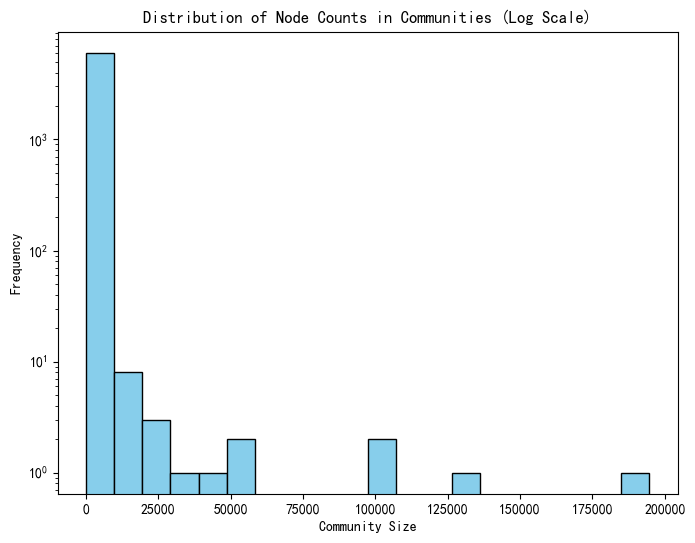

In [54]:
import matplotlib.pyplot as plt
import numpy as np

# Get the number of nodes in each community
community_sizes = communities.sizes()

# Plot a histogram of node counts on a logarithmic scale
plt.figure(figsize=(8, 6))
plt.hist(community_sizes, bins=20, color='skyblue', edgecolor='black', log=True)
plt.xlabel('Community Size')
plt.ylabel('Frequency')
plt.title('Distribution of Node Counts in Communities (Log Scale)')
plt.show()


In [59]:
# Obtain the vertex lists of the top three largest communities within the largest connected component
top_three_communities = [largest_component.subgraph(subgraph) for subgraph in communities][:3]

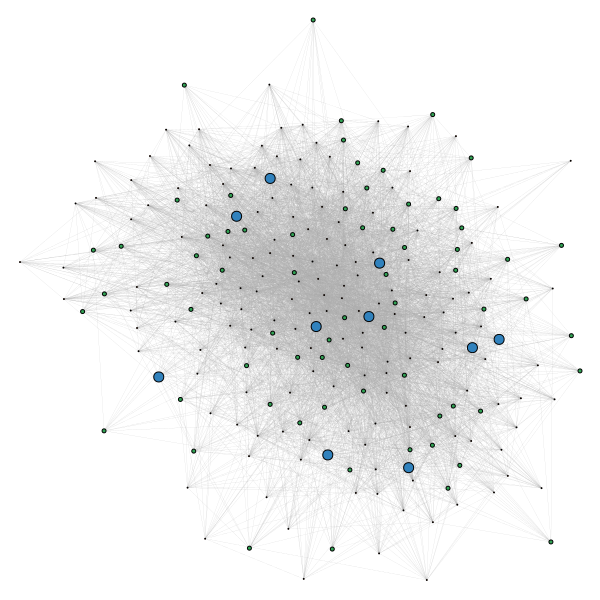

In [33]:
plot_subgraph(top_three_communities[0])

**Core-Homogeneous Loosely Connected Communities**: The core points within the community are uniformly distributed across various locations in the graph.

In [34]:
plot_subgraph(top_three_communities[1])

**Core-Dense Communities**: The core points within the community are densely interconnected.

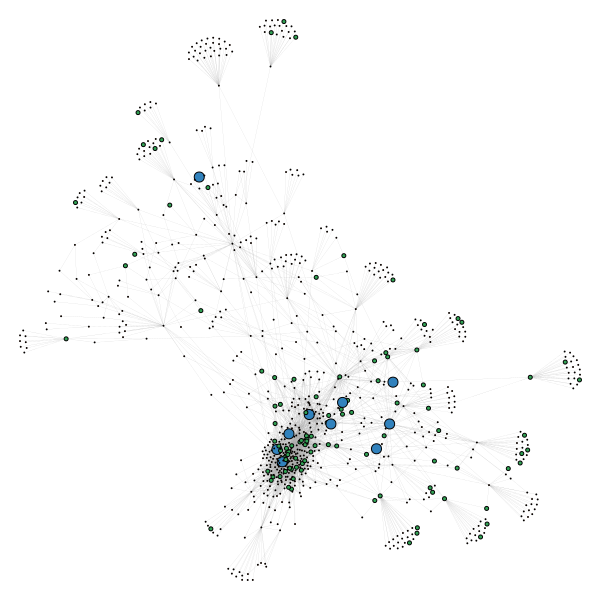

In [35]:
plot_subgraph(top_three_communities[2])

**"Star-Satellite" communities**: The central core forms the largest 'star' community, surrounded by several 'satellite' communities orbiting around it.